In [43]:
%load_ext autoreload
%autoreload 2

In [31]:
import pickle
from PIL import Image
import glob
from IPython.display import display
import cv2
import numpy as np
from pathlib import Path

In [22]:
video_id = 'video_0001'

In [23]:
annotations_path = "DATA/annotations/JAAD/anns/JAAD_DATA.pkl"
with open(annotations_path, 'rb') as f:
    annotations = pickle.load(f)

for feature, value in annotations[video_id].items():
    if feature == 'ped_annotations':
        print(f"{feature}:")
        for sub_feature, sub_value in value.items():
            print(f"\t{sub_feature}: {sub_value.keys()}")
    else:
        print(f"{feature}: {value}")

num_frames: 600
width: 1920
height: 1080
ped_annotations:
	0_1_3b: dict_keys(['old_id', 'frames', 'bbox', 'occlusion', 'behavior', 'attributes', 'appearance'])
	0_1_2: dict_keys(['old_id', 'frames', 'bbox', 'occlusion', 'behavior', 'attributes', 'appearance'])
	0_1_2b: dict_keys(['old_id', 'frames', 'bbox', 'occlusion', 'behavior', 'attributes', 'appearance'])
	0_1_4: dict_keys(['old_id', 'frames', 'bbox', 'occlusion', 'behavior', 'attributes', 'appearance'])
vehicle_annotations: {0: 1, 1: 1, 2: 1, 3: 1, 4: 1, 5: 1, 6: 1, 7: 1, 8: 1, 9: 1, 10: 1, 11: 1, 12: 1, 13: 1, 14: 1, 15: 1, 16: 1, 17: 1, 18: 1, 19: 1, 20: 1, 21: 1, 22: 1, 23: 1, 24: 1, 25: 1, 26: 1, 27: 1, 28: 1, 29: 1, 30: 1, 31: 1, 32: 1, 33: 1, 34: 1, 35: 1, 36: 1, 37: 1, 38: 1, 39: 1, 40: 1, 41: 1, 42: 1, 43: 1, 44: 1, 45: 1, 46: 1, 47: 1, 48: 1, 49: 1, 50: 1, 51: 1, 52: 1, 53: 1, 54: 1, 55: 1, 56: 1, 57: 3, 58: 3, 59: 3, 60: 3, 61: 3, 62: 3, 63: 3, 64: 3, 65: 3, 66: 3, 67: 3, 68: 3, 69: 3, 70: 3, 71: 3, 72: 3, 73: 3, 74: 3,

Frame 0: 0


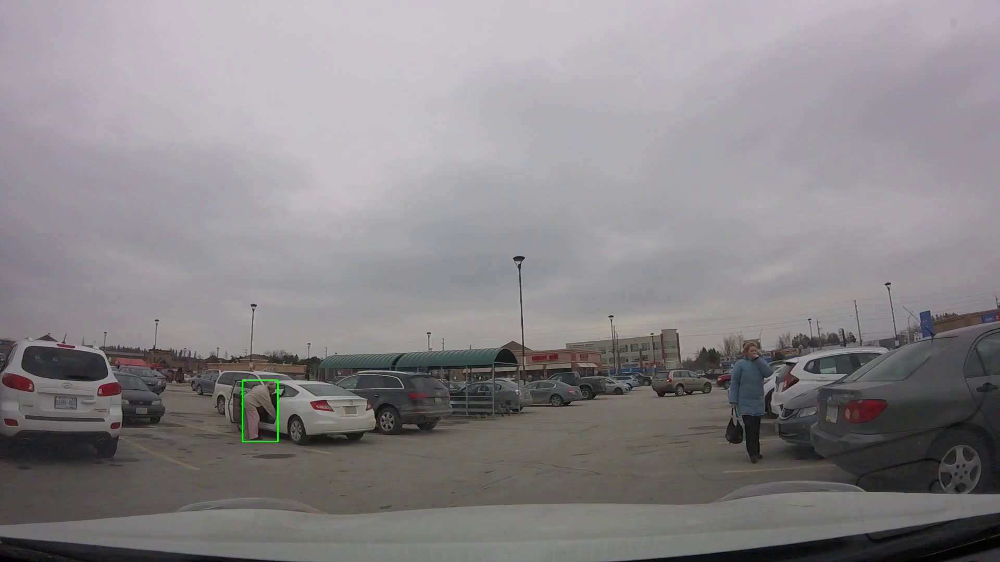

Frame 554: 1


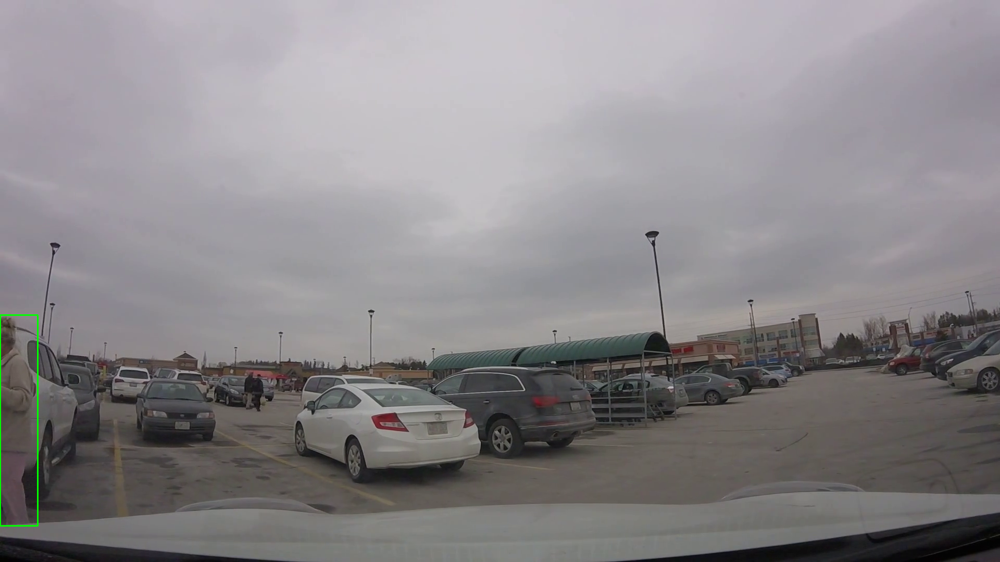

Frame 557: 2


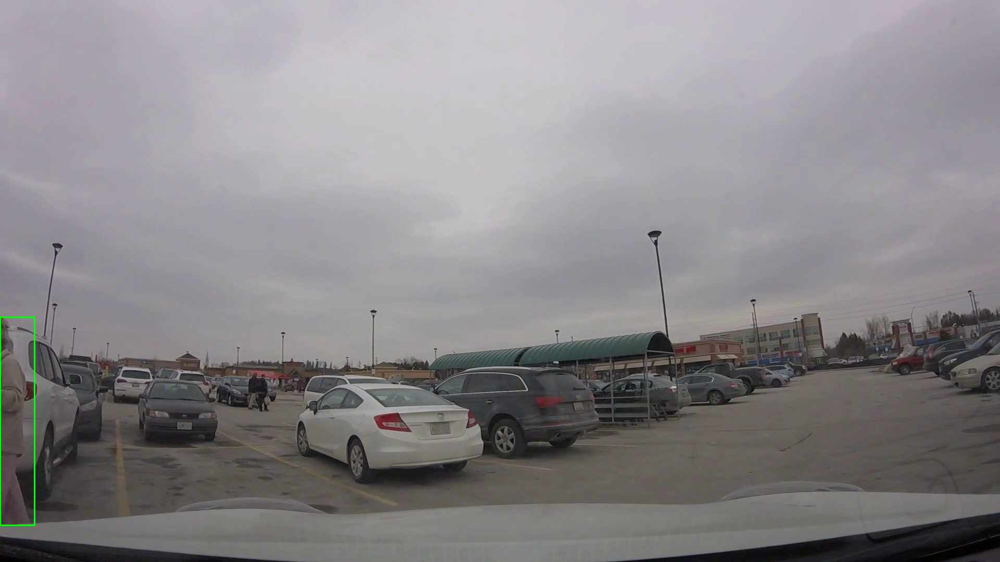

In [24]:
frame_folder = f"DATA/images/JAAD/{video_id}"
ped_id = '0_1_3b'
example_occlusions = annotations[video_id]['ped_annotations'][ped_id]['occlusion']
pedestrian_frames =  annotations[video_id]['ped_annotations'][ped_id]['frames']
pedestrian_bboxes =  annotations[video_id]['ped_annotations'][ped_id]['bbox']
frames = [Image.open(image).convert('RGB') for image in sorted(glob.glob(f"{frame_folder}/*.png"))]

seen_occlusions = set()

assert len(pedestrian_frames) == len(example_occlusions), "Number of frames and occlusions doesn't match"
assert len(pedestrian_frames) == len(pedestrian_bboxes), "Number of frames and occlusions doesn't match"
for frame_id, occlusion_label, bbox in zip(pedestrian_frames, example_occlusions, pedestrian_bboxes):
    if occlusion_label not in seen_occlusions:
        print(f"Frame {frame_id}: {occlusion_label}")
        seen_occlusions.add(occlusion_label)
        x0, y0, x1, y1 = bbox
        start_point = (int(x0), int(y0))
        end_point = (int(x1), int(y1))
        img = cv2.rectangle(np.array(frames[frame_id]), start_point, end_point, color=(0,255,0), thickness=2)
        display(Image.fromarray(img))

In [36]:
import os
ds_folder = "DATA/images/JAAD"
annotations_path = "DATA/annotations/JAAD/anns/JAAD_DATA.pkl"
output_dir = Path("DATA/filtering/JAAD/")
output_file = output_dir / "occluded_frames.txt"

output_dir.mkdir(parents=True, exist_ok=True)

with open(annotations_path, 'rb') as f:
    annotations = pickle.load(f)

with open(output_file, 'w') as f:
    frame_folders = sorted(glob.glob(f"{ds_folder}/*/"))
    for frame_folder in frame_folders:
        video_id = frame_folder.split('/')[-2]
        for ped_id in annotations[video_id]['ped_annotations']:
            example_occlusions = annotations[video_id]['ped_annotations'][ped_id]['occlusion']
            pedestrian_frames =  annotations[video_id]['ped_annotations'][ped_id]['frames']
            pedestrian_bboxes =  annotations[video_id]['ped_annotations'][ped_id]['bbox']
            occluded_frames = [frame_id for frame_id, occlusion_label in zip(pedestrian_frames, example_occlusions) if occlusion_label == 2]
            occluded_frames = np.array(occluded_frames)
            occluded_dist = occluded_frames[1:] - occluded_frames[:-1]
            assert occluded_dist.mean() == 1 and occluded_dist.std() == 0, f"Occluded frames are not consecutive: {occluded_frames}"

    


AssertionError: Occluded frames are not consecutive: [ 18  20  21 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136
 137 138 139 140]

In [26]:
frame_folder = f"DATA/images/JAAD/{video_id}"
ped_id = '0_1_3b'
example_occlusions = annotations[video_id]['ped_annotations'][ped_id]['occlusion']
pedestrian_frames =  annotations[video_id]['ped_annotations'][ped_id]['frames']
pedestrian_bboxes =  annotations[video_id]['ped_annotations'][ped_id]['bbox']
frames = [Image.open(image).convert('RGB') for image in sorted(glob.glob(f"{frame_folder}/*.png"))]


assert len(pedestrian_frames) == len(example_occlusions), "Number of frames and occlusions doesn't match"
assert len(pedestrian_frames) == len(pedestrian_bboxes), "Number of frames and occlusions doesn't match"
occluded_frames = []
for frame_id, occlusion_label, bbox in zip(pedestrian_frames, example_occlusions, pedestrian_bboxes):
    # fully occluded
    if occlusion_label == 2:
        occluded_frames.append(frame_id)
occluded_frames = np.array(occluded_frames)
occluded_dist = occluded_frames[1:] - occluded_frames[:-1]
print(occluded_dist.mean(), occluded_dist.std())

1.0 0.0


Frame 557: 2


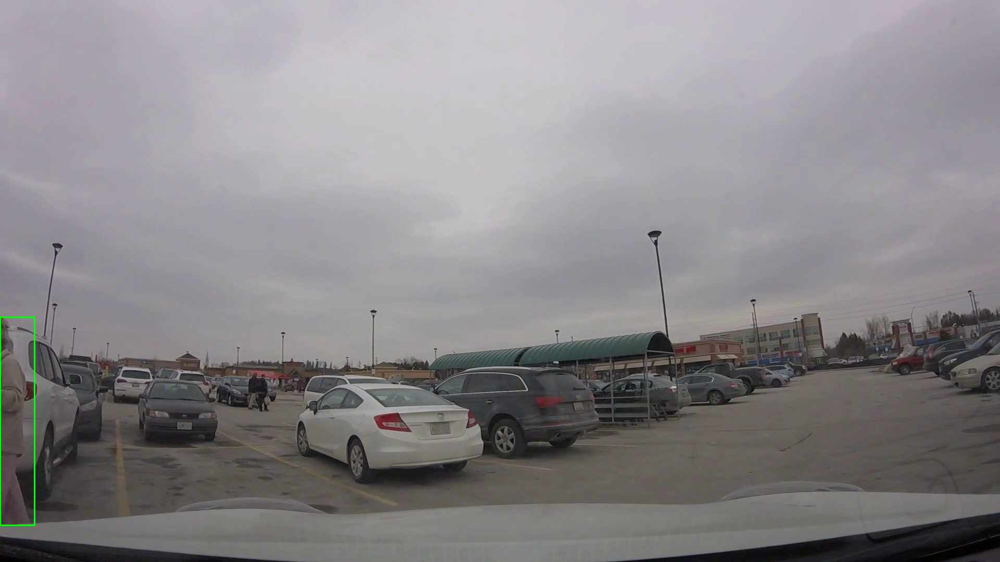

Frame 558: 2


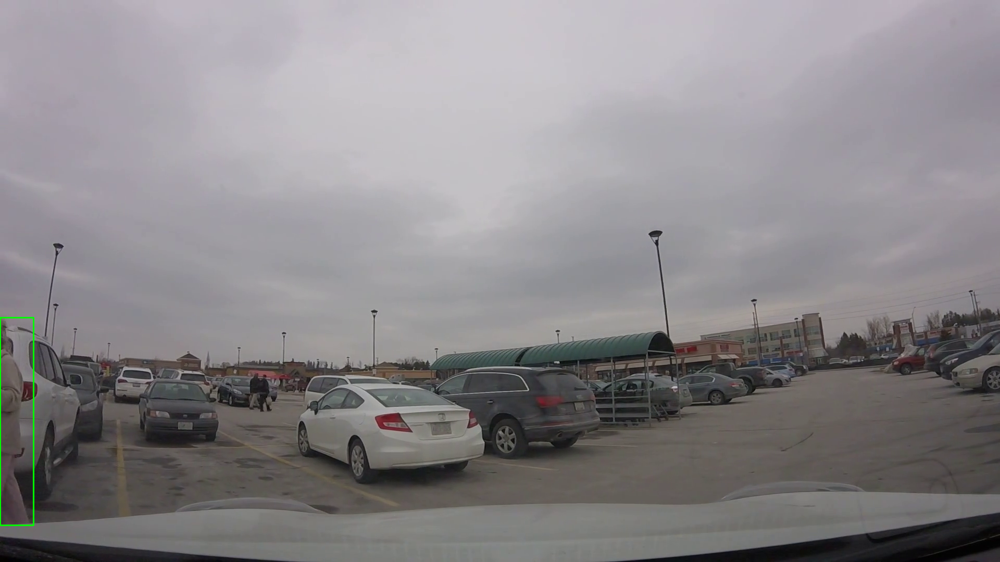

Frame 559: 2


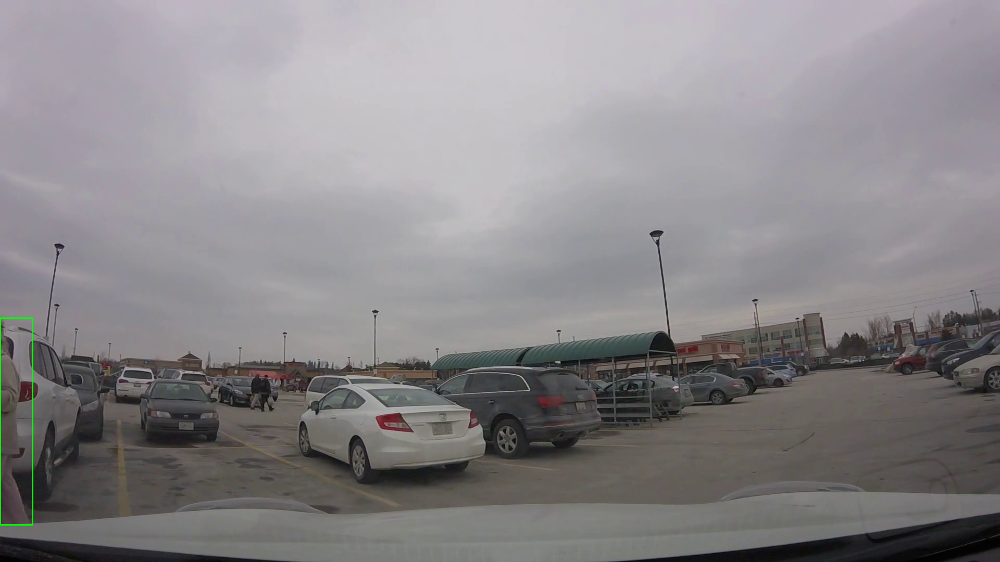

Frame 560: 2


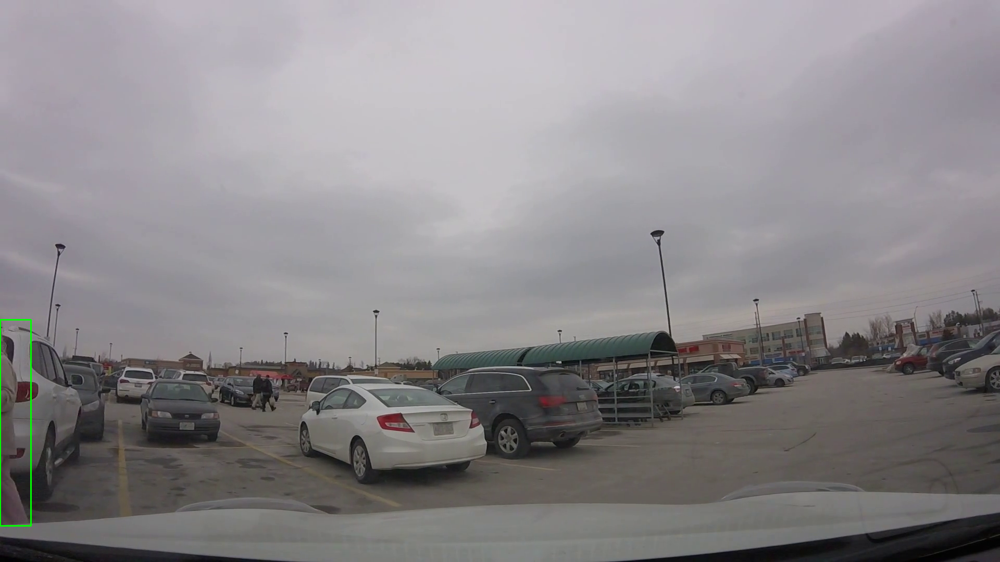

Frame 561: 2


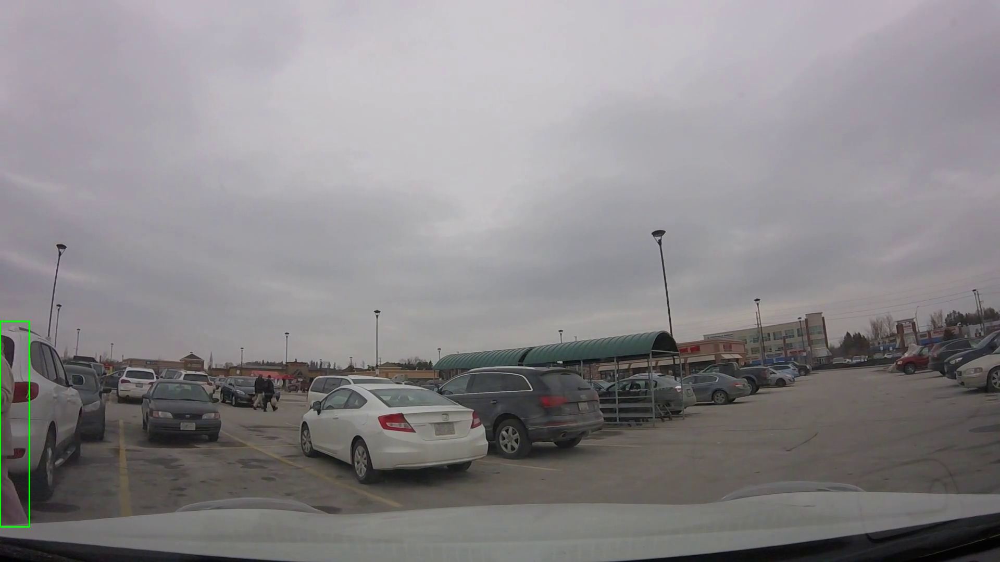

Frame 562: 2


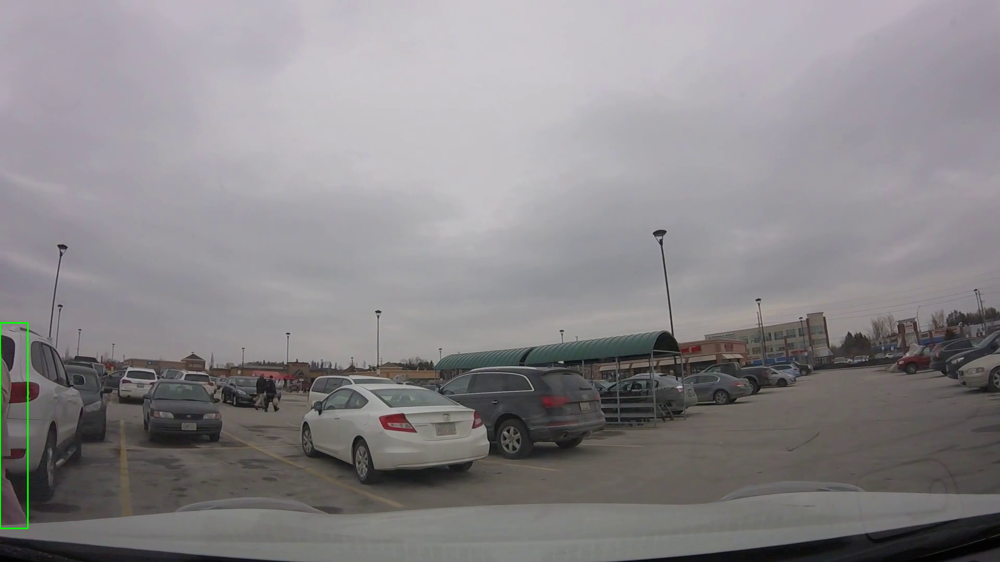

Frame 563: 2


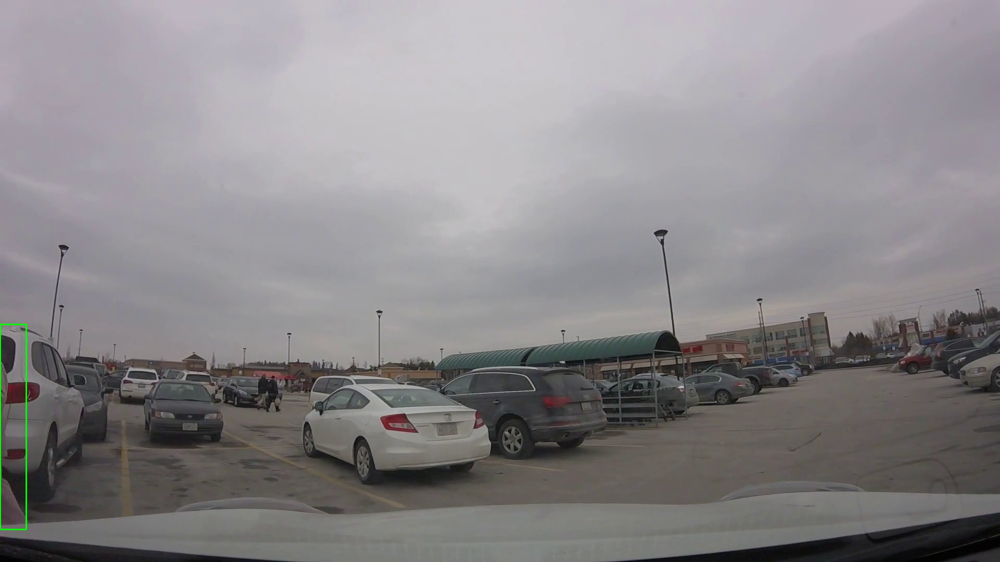

Frame 564: 2


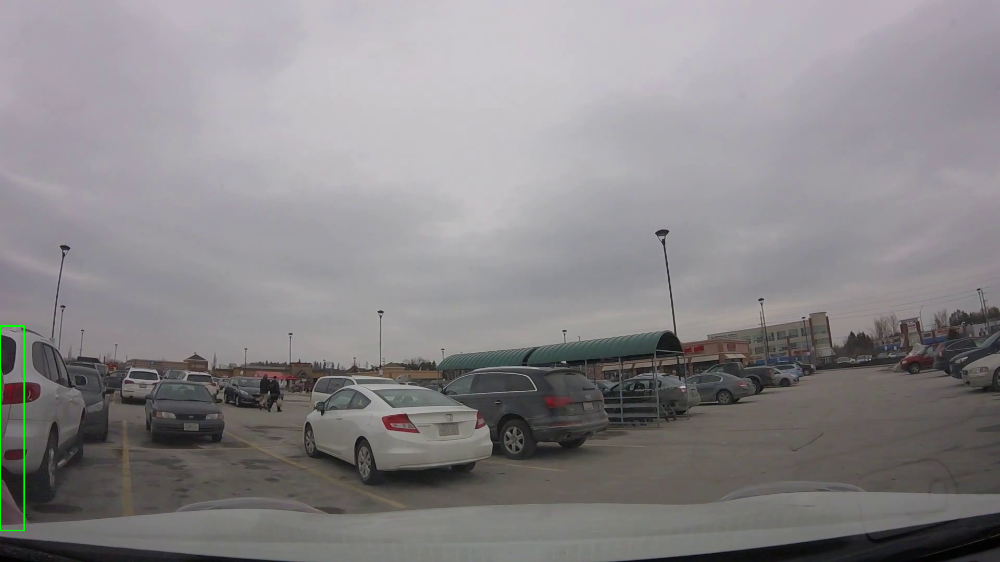

Frame 565: 2


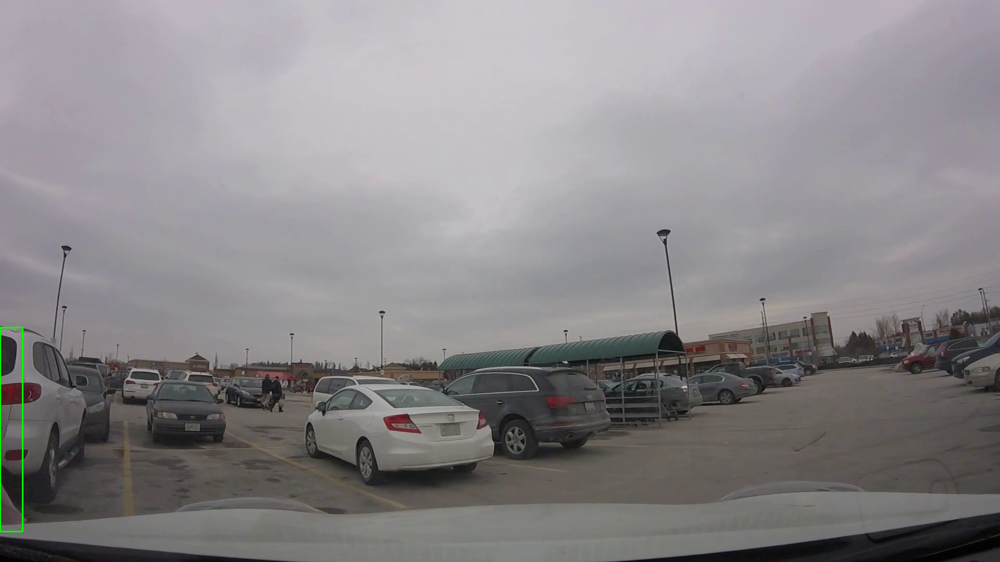

Frame 566: 2


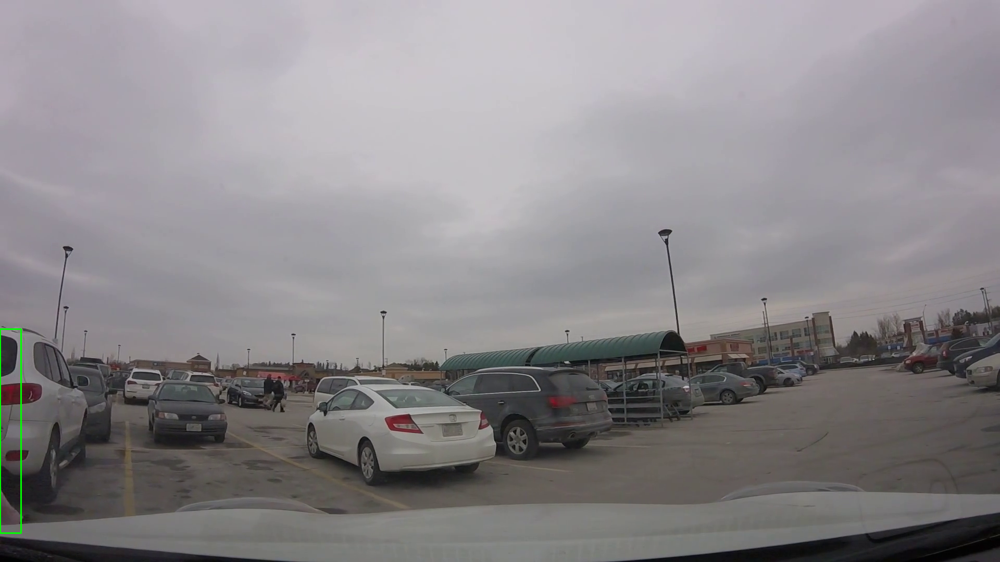

Frame 567: 2


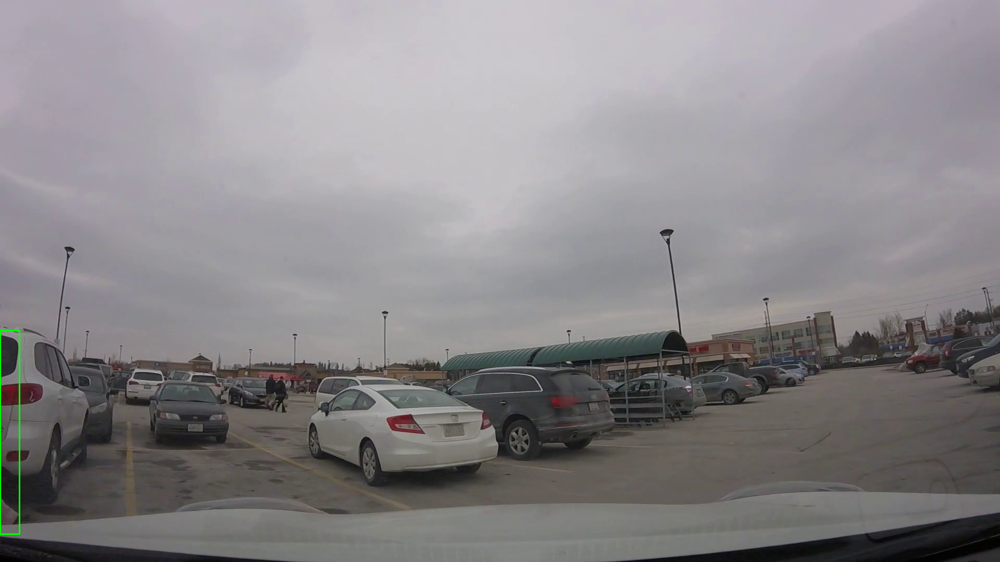

Frame 568: 2


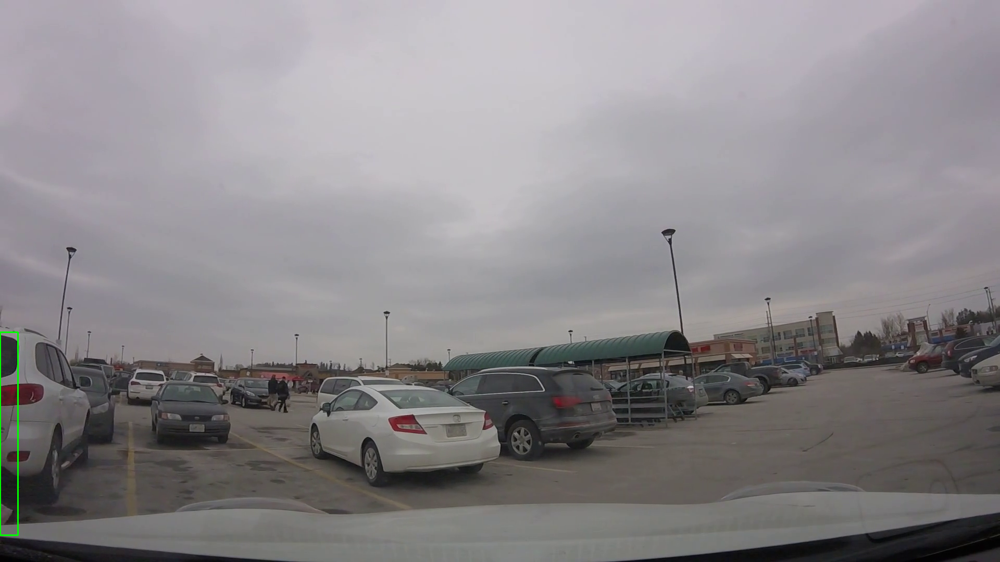

In [25]:
frame_folder = f"DATA/images/JAAD/{video_id}"
ped_id = '0_1_3b'
example_occlusions = annotations[video_id]['ped_annotations'][ped_id]['occlusion']
pedestrian_frames =  annotations[video_id]['ped_annotations'][ped_id]['frames']
pedestrian_bboxes =  annotations[video_id]['ped_annotations'][ped_id]['bbox']
frames = [Image.open(image).convert('RGB') for image in sorted(glob.glob(f"{frame_folder}/*.png"))]


assert len(pedestrian_frames) == len(example_occlusions), "Number of frames and occlusions doesn't match"
assert len(pedestrian_frames) == len(pedestrian_bboxes), "Number of frames and occlusions doesn't match"
for frame_id, occlusion_label, bbox in zip(pedestrian_frames, example_occlusions, pedestrian_bboxes):
    # fully occluded
    if occlusion_label == 2:
        print(f"Frame {frame_id}: {occlusion_label}")
        seen_occlusions.add(occlusion_label)
        x0, y0, x1, y1 = bbox
        start_point = (int(x0), int(y0))
        end_point = (int(x1), int(y1))
        img = cv2.rectangle(np.array(frames[frame_id]), start_point, end_point, color=(0,255,0), thickness=2)
        display(Image.fromarray(img))

In [2]:
def make_gif(frame_folder):
    frames = [Image.open(image) for image in glob.glob(f"{frame_folder}/*.png")]
    frame_one = frames[0]
    frame_one.save(f"{frame_folder}.gif", format="GIF", append_images=frames,
               save_all=True, duration=100, loop=0)
    return f"{frame_folder}.gif"
    
gif_path = make_gif("DATA/images/JAAD/video_0001")

In [116]:
from src.dataset.Loader.main_loader import define_path
from src.dataset.trans.data import TransDataset, extract_pred_sequence
from src.dataset.trans.jaad_trans import JaadTransDataset
from src.dataset.intention.jaad_dataset import build_pedb_dataset_jaad, subsample_and_balance

In [117]:
anns_paths, image_dir = define_path(use_jaad=True, use_pie=False, use_titan=False)
anns_paths_val, image_dir_val = define_path(use_jaad=True, use_pie=False, use_titan=False)

In [118]:
intent_sequences = build_pedb_dataset_jaad(anns_paths["JAAD"]["anns"], anns_paths["JAAD"]["split"], image_set = "train", fps=5, verbose=True)
intent_sequences_cropped = subsample_and_balance(intent_sequences, max_frames=10)

----------------------------------------------------------------
JAAD:
Total number of crosses: 5418
Total number of non-crosses: 3371
Filtered samples: 9


In [119]:
from src.dataset.trans.jaad_trans import get_split_vids, get_pedb_ids_jaad
ids = get_pedb_ids_jaad(annotations, video_id)
print(ids)

['0_11_56b']


In [127]:
video_id = 'video_0001'
video_samples = []
for sample in intent_sequences_cropped:
    if sample['video_number'] == video_id:
        video_samples.append(sample)
video_samples = sorted(video_samples, key=lambda x: x['sample_id'])
for sample in video_samples:
    print(sample['ped_id'])
sample = video_samples[0]

0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b
0_1_3b


In [128]:
sample

{'sample_id': '0_1_3b_video_0001_0',
 'frames': [0, 6, 12, 18, 24, 30, 36, 42, 48, 54],
 'bbox': [[465.0, 730.0, 533.0, 848.0],
  [454.0, 731.0, 528.0, 851.0],
  [443.0, 732.0, 522.0, 855.0],
  [439.0, 726.0, 514.0, 855.0],
  [438.0, 721.0, 505.0, 855.0],
  [437.0, 714.0, 499.0, 856.0],
  [438.0, 704.0, 496.0, 859.0],
  [437.0, 702.0, 495.0, 860.0],
  [436.0, 700.0, 493.0, 861.0],
  [439.0, 700.0, 497.0, 864.0]],
 'action': [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 'occlusion': [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 'behavior': [[0, 0, 0, 0],
  [0, 0, 0, 0],
  [0, 0, 0, 0],
  [0, 0, 0, 0],
  [0, 0, 0, 0],
  [0, 0, 0, 0],
  [0, 0, 0, 0],
  [0, 0, 0, 0],
  [0, 0, 0, 0],
  [0, 0, 0, 0]],
 'traffic_light': [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
 'label': 0,
 'video_number': 'video_0001',
 'attributes': [2, 0, 0, 0, 1],
 'ped_id': '0_1_3b'}

Video video_0001, Pedestrian 0_1_3b
Frame 0
0


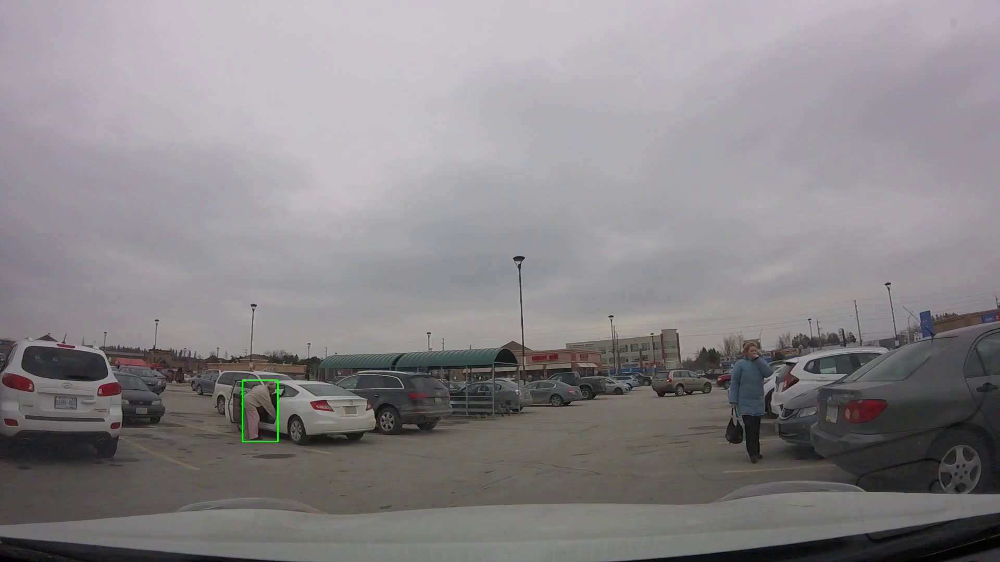

Frame 6
0


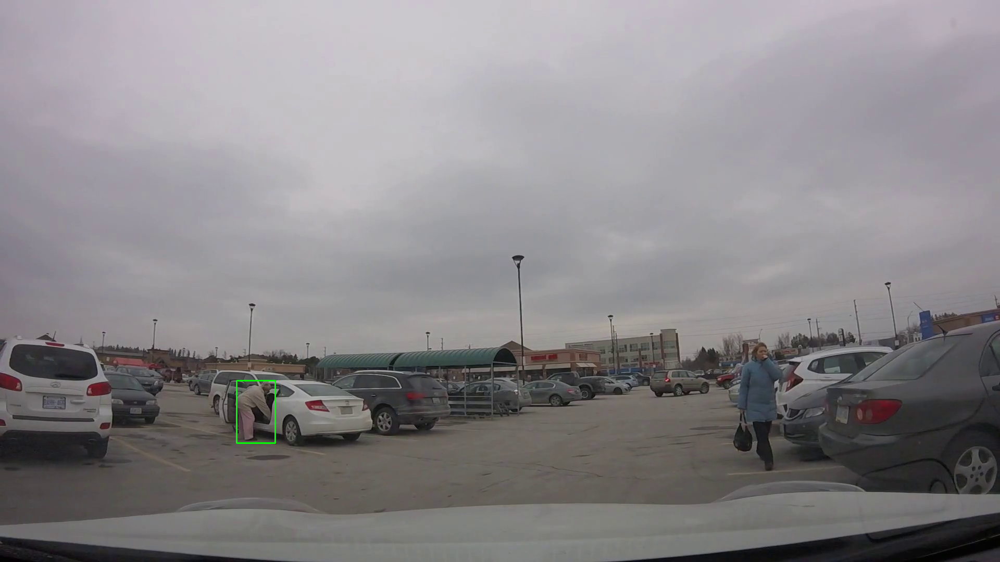

Frame 12
0


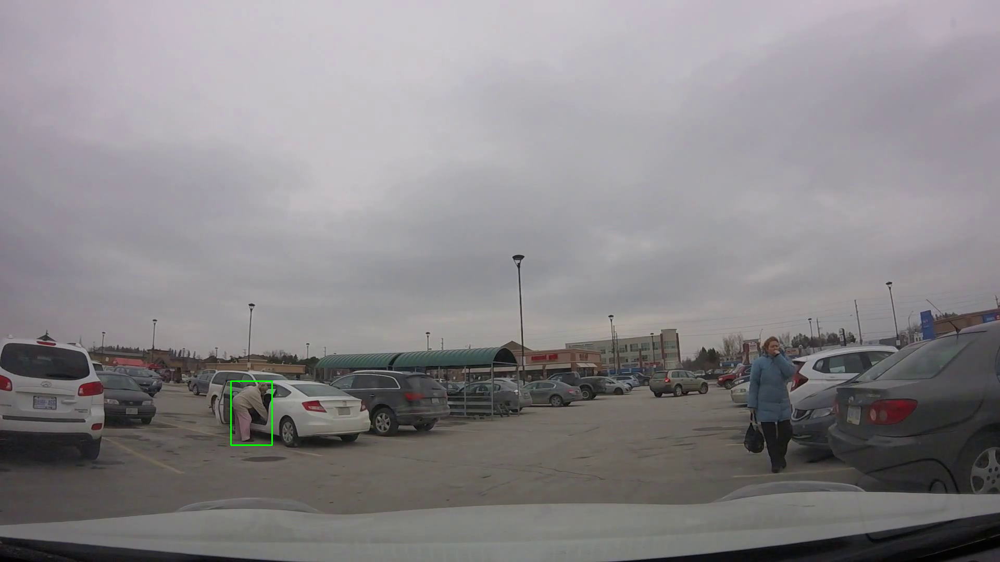

Frame 18
0


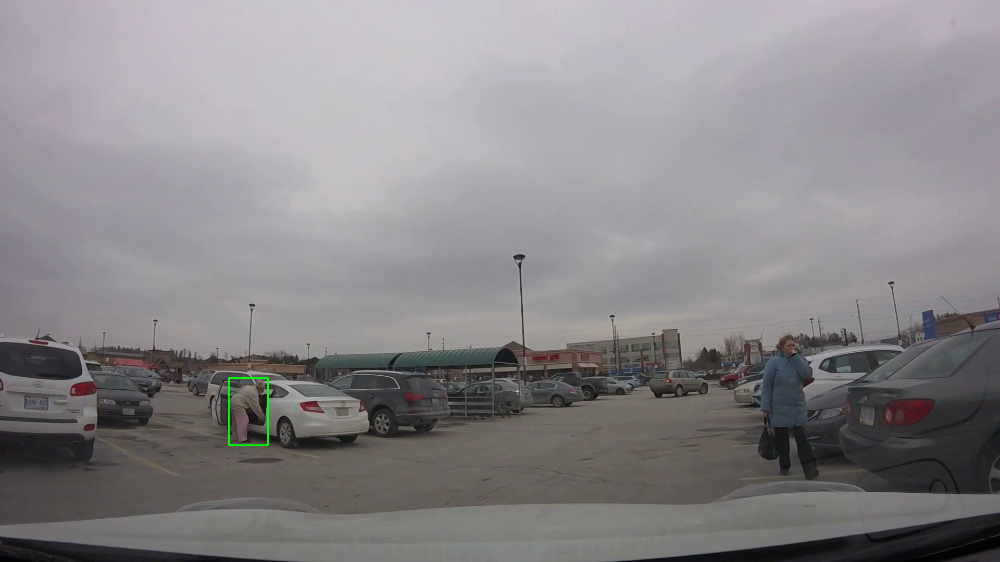

Frame 24
0


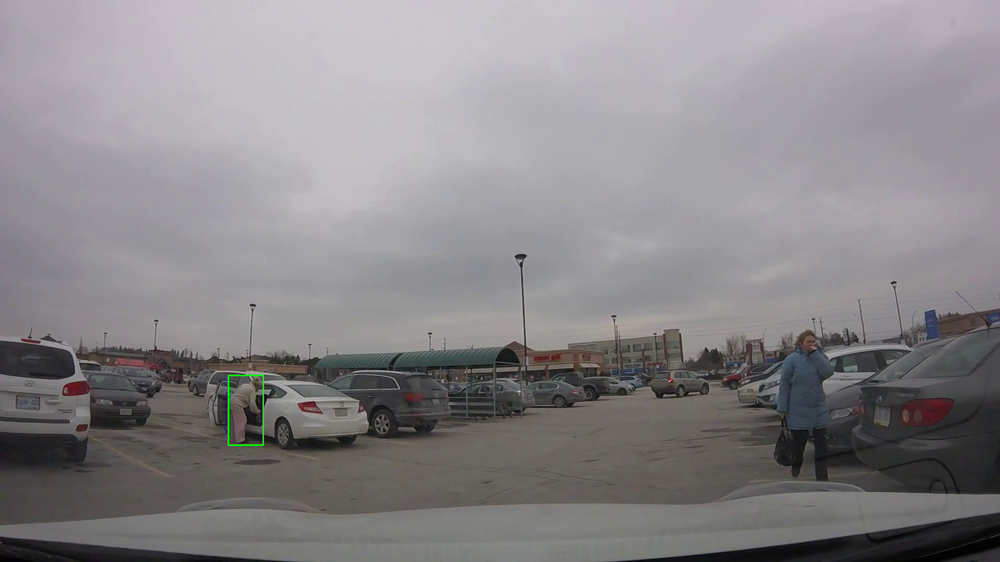

Frame 30
0


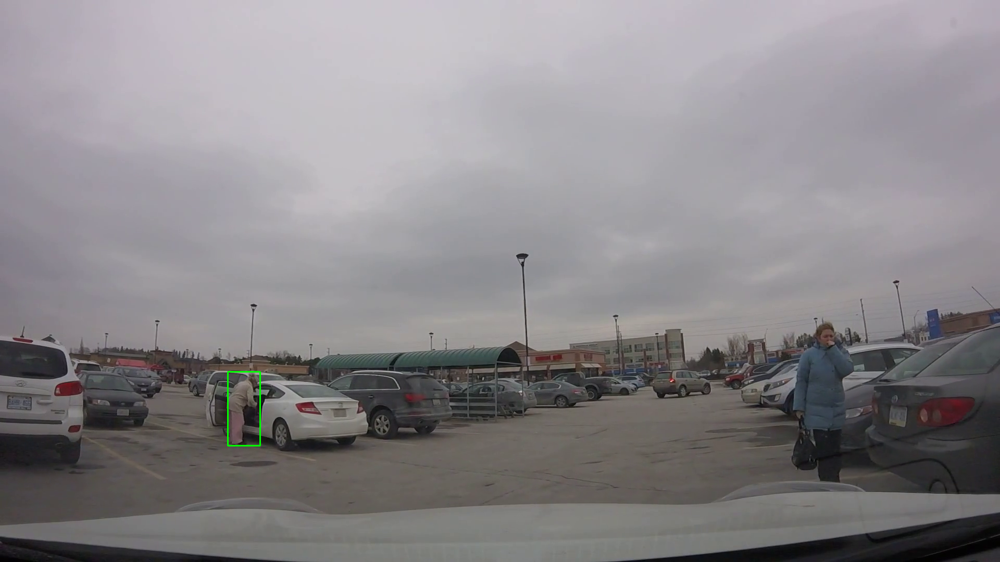

Frame 36
0


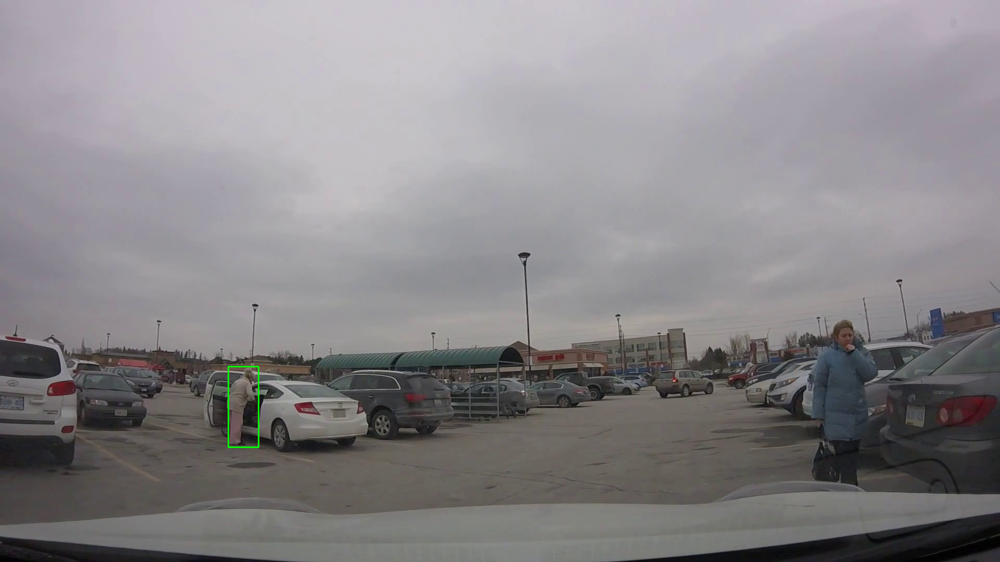

Frame 42
0


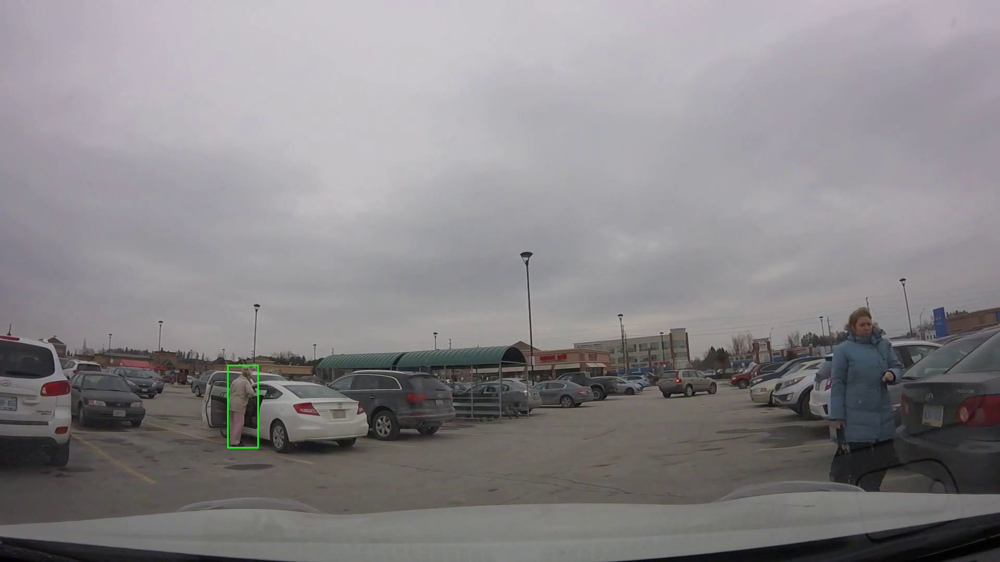

Frame 48
0


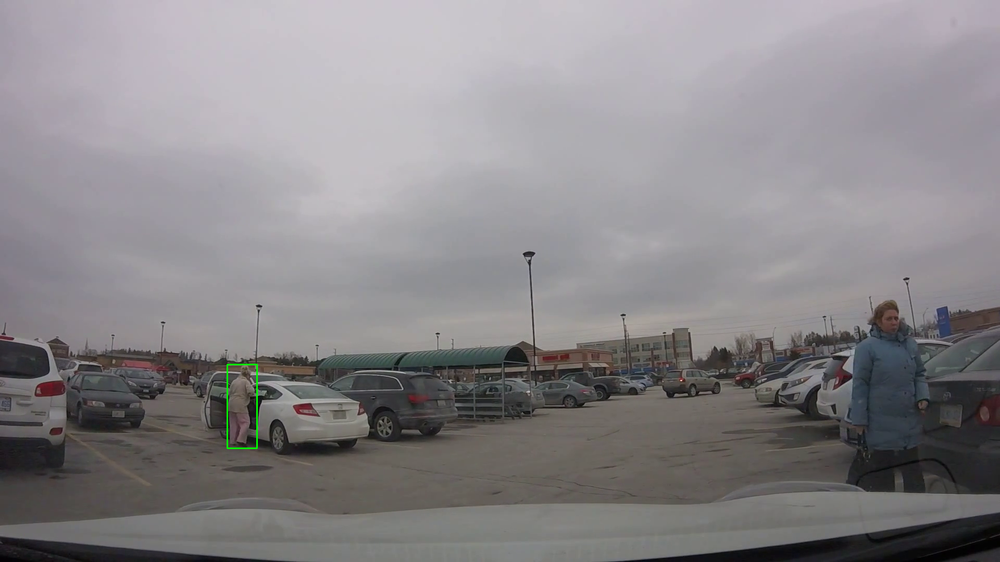

Frame 54
0


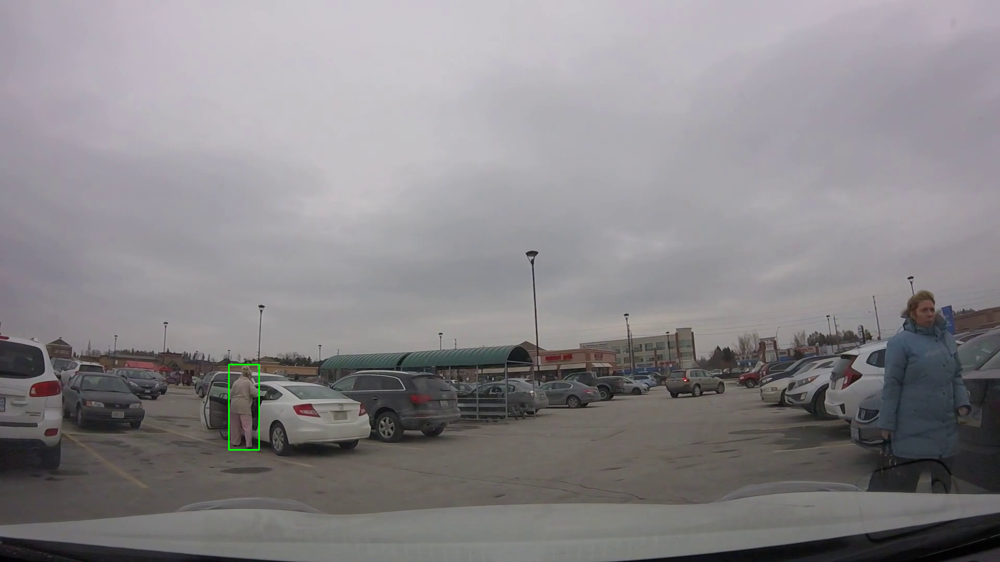

In [129]:
video_id = sample['video_number']
ped_id = sample['ped_id']
print(f"Video {video_id}, Pedestrian {ped_id}")
pedestrian_frames = sample['frames']
pedestrian_bboxes = sample['bbox']

frame_folder = f"DATA/images/JAAD/{video_id}"

frames = [Image.open(image).convert('RGB') for image in sorted(glob.glob(f"{frame_folder}/*.png"))]

assert len(pedestrian_frames) == len(pedestrian_bboxes), "Number of frames and occlusions doesn't match"
for frame_id, bbox in zip(pedestrian_frames, pedestrian_bboxes):
    print(f"Frame {frame_id}")
    print(sample['label'])
    x0, y0, x1, y1 = bbox
    start_point = (int(x0), int(y0))
    end_point = (int(x1), int(y1))
    img = cv2.rectangle(np.array(frames[frame_id]), start_point, end_point, color=(0,255,0), thickness=2)
    display(Image.fromarray(img))